### **Students Details:**
- Guy Kabiri 312252224
- Tomer Dwek 313229486

# Imports

In [1]:
import time
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import pandas as pd

from tqdm import tqdm
from matplotlib import pyplot as plt
import seaborn as sns
from google.colab import drive
import os 
import zipfile
import glob
import albumentations as A

In [2]:
!pip install torchmetrics timm

     |████████████████████████████████| 276kB 9.9MB/s 
     |████████████████████████████████| 348kB 20.9MB/s 


In [3]:
import torchmetrics 

In [4]:
!pip install -U git+https://github.com/albu/albumentations > /dev/null

  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-yfx6lzc9


In [5]:
from albumentations.pytorch import ToTensorV2

In [6]:
!pip install timm

In [7]:
import timm

In [8]:
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard 
# %reload_ext tensorboard

# General Definitions

In [9]:
SEED = 0
np.random.seed(SEED)

BATCH_SIZE = 32
NUM_CLASSES = 3
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Importing Data

In [10]:
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [17]:
GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE = 'Colab Notebooks/Computer Vision/Assignment 3/Afeka CV 2021'
GOOGLE_DRIVE_PATH = os.path.join('drive', 'My Drive', GOOGLE_DRIVE_PATH_AFTER_MY_DRIVE)

In [18]:
good_folders = ['Tomer Dwek', 'Guy Kabiri', 'Almog Amiga', 'Daniel Wurms', 'Noam Levi', 'Shahar Michaeli', 'Salo Elia', 'Oded Nir', 'Evyatar Menczer', 'Omri Kireev']

In [19]:
class FacesData:
    def __init__(self, path):
        self.images = []
        self.labels = []

        folders = os.listdir(path)
        self.num_classes = 0
        for folder in good_folders:
            if folder not in good_folders:
                continue
            self.num_classes += 1
            folder_path = os.path.join(path, folder)
            folder_images = os.listdir(folder_path)

            for file in folder_images:
                self.labels.append(folder)
                img_path = os.path.join(folder_path, file)
                self.images.append(img_path)
        
        self.images = np.array(self.images)
        self.labels = np.array(self.labels)

    def load_data(self, train_size=.8, drop_rate=0):

        if train_size > 1 or train_size < 0:
            raise ValueError("Split sizes can not be greater than 1 or less than 0")

        if drop_rate > 0:
            self.images = self.images[:int(len(self.images) * (1 - drop_rate))]
            self.labels = self.labels[:int(len(self.labels) * (1 - drop_rate))]

        test_size = 1 - train_size
        x_train, x_test, y_train, y_test = train_test_split(self.images, self.labels, test_size=test_size, random_state=SEED)

        return (x_train, y_train), (x_test, y_test)

In [20]:
class FacesDataSet(Dataset):
    def __init__(self, data, labels, size=224, transforms=None):
        self.x = data
        self.y = labels
        self.all_names = np.unique(labels)
        self.size = size
        self.transforms = transforms

    def __getitem__(self, idx):
        img_path = self.x[idx]          #   the image
        label = self.y[idx]             #   the actual text label
        y = np.where(self.all_names == label)[0][0]   #   integere value for model prediction

        x = cv2.imread(img_path)
        x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)
        x = cv2.resize(x, (self.size, self.size), cv2.INTER_AREA)
        if self.transforms:
            x = self.transforms(image = x)
            x = x['image']
        else:
            x = np.transpose(x, (2, 0, 1))

        return x, y, label

    def __len__(self):
        return len(self.x)

In [21]:
train_transformations = A.Compose([
                             A.Blur(blur_limit=10, p=0.3),
                             A.GaussNoise(var_limit=(0, 500), p=0.3),
                             ToTensorV2(),
])

valid_transformations = A.Compose([
                             ToTensorV2(),
])

In [22]:
faces = FacesData(GOOGLE_DRIVE_PATH)
(x_train, y_train), (x_valid, y_valid) = faces.load_data()

In [23]:
trainset = FacesDataSet(x_train, y_train, transforms=train_transformations)
validset = FacesDataSet(x_valid, y_valid, transforms=valid_transformations)

In [24]:
print(f'In this training set we have got a total of {len(trainset)}')
print(f'In this validation set we have got a total of {len(validset)}')

In this training set we have got a total of 160
In this validation set we have got a total of 40


In [25]:
train_loader = DataLoader(dataset=trainset, batch_size= BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(dataset=validset, batch_size= BATCH_SIZE, shuffle=False)

In [26]:
def norm(img):
    img = np.array(img)
    img = img.astype(np.float32)
    img -= img.min()
    img /= img.max()
    return img

In [27]:
def show_samples(loader):
    plt.figure(figsize=(20, 10))
    images, _, labels = next(iter(loader))
    for idx, img, lbl in zip(range(BATCH_SIZE), images, labels):
        plt.subplot(4, 8, idx + 1)
        plt.title(lbl)
        plt.axis("off")
        img = np.transpose(img, (1, 2, 0))
        plt.imshow(norm(img))
        
    plt.show()

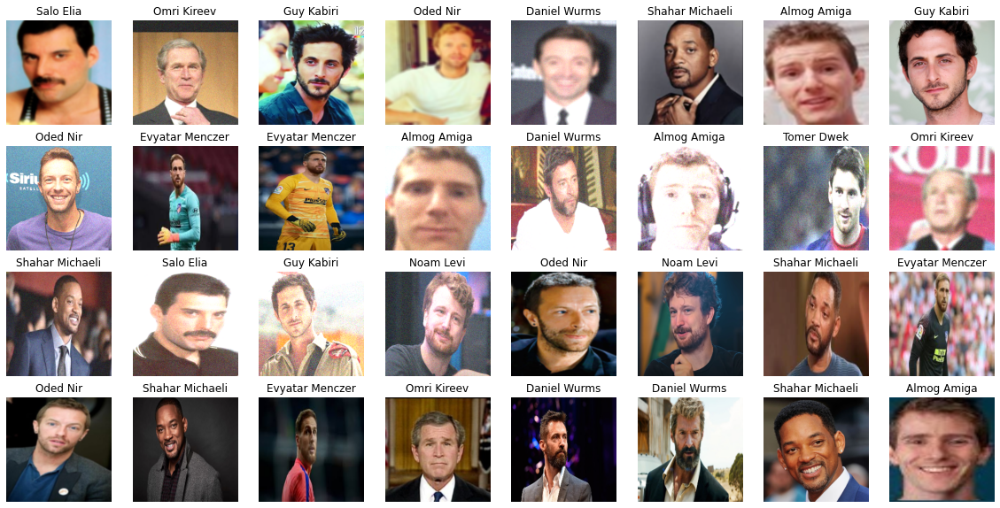

In [28]:
show_samples(train_loader)

# VGG16

In [29]:
class VGG16(nn.Module):
    architecture = [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512, 'M', 512, 512, 512, 'M']
    def __init__(self, in_channels=3, num_classes=24):
        super(VGG16, self).__init__()
        self.in_channels = in_channels
        self.num_classes = num_classes

        conv_layers = []
        in_ch = in_channels

        for layer in self.architecture:
            if type(layer) is int:
                out_ch = layer

                conv_layers += [nn.Conv2d(in_channels=in_ch,
                                     out_channels=out_ch,
                                     kernel_size=(3, 3),
                                     padding=(1, 1)),
                           nn.BatchNorm2d(layer),
                           nn.ReLU()]
                in_ch = out_ch
            
            elif layer == 'M':
                conv_layers += [nn.MaxPool2d(kernel_size=(2, 2),
                                        stride=(2, 2))]
        
        self.conv_layers = nn.Sequential(*conv_layers)

        self.fully_connected = nn.Sequential(
            nn.Linear(512*7*7, 4096),
            nn.ReLU(),
            nn.Dropout(p=0.2),
            nn.Linear(4096, 4096),
            nn.ReLU(),
            nn.Dropout(p=0.2),
            nn.Linear(4096, num_classes))

    def forward(self, x):
        x = self.conv_layers(x.float())
        x = x.view(x.shape[0], -1)
        x = self.fully_connected(x)
        return x


In [30]:
def save_model(model, optimizer, epoch, loss, path):
    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss,
            }, path)
  
def load_model(path, model, optimizer):
    checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    loss = checkpoint['loss']
    return epoch, loss

In [31]:
class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [32]:
def evaluate (y_pred, targets):    
    corrects = 0.0
    for t, y in zip(targets, y_pred):
        if t == y:
            corrects += 1.0
    return corrects

# Training And Validation Functions

In [33]:
def train(loader, model, optimizer, criterion, epoch, writer):
    model.train()

    running_loss, running_accuracy, samples = 0.0, 0.0, 0

    with tqdm(total=len(loader), desc='Train') as progress_bar:
        for (x_batch, y_batch, _) in loader:           
            x_batch = x_batch.float().to(device)  
            y_batch = y_batch.long().to(device)

            optimizer.zero_grad()
            output = model(x_batch)

            loss = criterion(output, y_batch)
            loss.backward()
            optimizer.step()

            _, pred = torch.max(output, 1)
            acc = (pred == y_batch).sum().item()

            running_loss += loss.item()
            running_accuracy += acc
            samples += x_batch.size(0)
            
            del x_batch
            del y_batch
            torch.cuda.empty_cache()
            progress_bar.update(1)

    writer.add_scalar('average loss', running_loss / samples, epoch + 1)
    writer.add_scalar('average accuracy', 100 * running_accuracy / samples, epoch + 1)

    return running_loss / samples, 100 * running_accuracy / samples

In [34]:
def validation(loader, model, criterion, epoch, writer):
    model.eval()

    running_loss, running_accuracy, samples = 0.0, 0.0, 0

    with tqdm(total=len(loader), desc='Valid') as progress_bar:
        for (x_batch, y_batch, _) in loader:
            with torch.no_grad():
                x_batch = x_batch.float().to(device)    
                y_batch = y_batch.long().to(device)

                output = model(x_batch)

                loss = criterion(output, y_batch)    

                _, pred = torch.max(output, 1)
                acc = (pred == y_batch).sum().item()

                running_loss += loss.item()
                running_accuracy += acc
                samples += x_batch.size(0)

            del x_batch
            del y_batch
            torch.cuda.empty_cache()
            progress_bar.update(1)

    writer.add_scalar('average loss', running_loss / samples, epoch + 1)
    writer.add_scalar('average accuracy', 100 * running_accuracy / samples, epoch + 1)

    return running_loss / samples, 100 * running_accuracy / samples

In [35]:
def train_model(train_loader, valid_loader, model, optimizer, criterion, start_epoch, epochs, export_name, exp_num, scheduler=None):
    torch.cuda.empty_cache()

    model = model.to(device)

    writer_train = SummaryWriter('runs/{}_train_{}'.format(export_name, exp_num))
    writer_valid = SummaryWriter('runs/{}_valid_{}'.format(export_name, exp_num))

    train_accs = []
    valid_accs = []
    train_losses = []
    valid_losses = []

    best_valid_score = 0
    for epoch in range(start_epoch, start_epoch + epochs):
        train_loss, train_accuracy = train(train_loader, model, optimizer, criterion, epoch, writer_train)
        train_losses.append(train_loss)
        train_accs.append(train_accuracy)
        
        valid_loss, valid_accuracy = validation(valid_loader, model, criterion, epoch, writer_valid)
        valid_losses.append(valid_loss)
        valid_accs.append(valid_accuracy)

        if scheduler:
            scheduler.step()

        print('\nEpoch {:3d}:\ttrain loss: {:g}\ttrain accuracy: {:g}\n\t\tvalid loss: {:g}\tvalid accuracy: {:g}'.format(epoch + 1, train_loss, train_accuracy, valid_loss, valid_accuracy), flush=True)

        if valid_accuracy > best_valid_score:
            path = '{}{}.pth'.format(export_name, exp_num)
            # save_model(model, optimizer, epochs, valid_loss, path)
            best_valid_score = valid_accuracy
            
    return train_losses, train_accs, valid_losses, valid_accs

In [36]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

In [71]:
def display_results(dataloader, model):
   plt.figure(figsize=(20, 15))
   x_batch, y_batch, _  = next(iter(dataloader))
   x_batch = x_batch.float().to(device)  
   y_batch = y_batch.to(device) 
   output = model(x_batch).argmax(dim=-1)
   
   for idx, img, pred, lbl in zip(range(len(x_batch)//2), x_batch, output, y_batch):
      plt.subplot(4, 4, idx + 1)
      correct_pred = pred == lbl
      plt.title('Original Label: {}, Pred Label: {}, Pred = {}'.format(lbl, pred, correct_pred))
      plt.axis("off")
      img = np.transpose(img.cpu(), (1, 2, 0))
      plt.imshow(norm(img))
    

### **Our VGG16 Model**

In [ ]:
experiment = 0

In [38]:
model = VGG16(num_classes=faces.num_classes)

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model.parameters())

In [39]:
%%time
train_model(train_loader, valid_loader, model, optimizer, criterion, start_epoch, epochs, export_name='VGG16', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:23<00:00, 11.63s/it]


Epoch   1:	train loss: 0.894318	train accuracy: 8.125
		valid loss: 102.977	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch   2:	train loss: 0.212376	train accuracy: 13.125
		valid loss: 17.494	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]


Epoch   3:	train loss: 0.0758039	train accuracy: 14.375
		valid loss: 5.95859	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]


Epoch   4:	train loss: 0.0757521	train accuracy: 13.75
		valid loss: 1.32857	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch   5:	train loss: 0.0773104	train accuracy: 14.375
		valid loss: 0.682201	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch   6:	train loss: 0.0744227	train accuracy: 15
		valid loss: 0.378193	valid accuracy: 17.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch   7:	train loss: 0.0713727	train accuracy: 14.375
		valid loss: 0.268515	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch   8:	train loss: 0.0859628	train accuracy: 16.875
		valid loss: 0.209925	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch   9:	train loss: 0.0691221	train accuracy: 16.875
		valid loss: 0.120139	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  10:	train loss: 0.0700011	train accuracy: 14.375
		valid loss: 0.204086	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  11:	train loss: 0.0963669	train accuracy: 18.125
		valid loss: 0.107219	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  12:	train loss: 0.0809455	train accuracy: 16.875
		valid loss: 0.106089	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  13:	train loss: 0.0717496	train accuracy: 11.875
		valid loss: 0.11137	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  14:	train loss: 0.0689949	train accuracy: 18.75
		valid loss: 0.107661	valid accuracy: 25



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]


Epoch  15:	train loss: 0.0690744	train accuracy: 20
		valid loss: 0.10359	valid accuracy: 22.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  16:	train loss: 0.0632075	train accuracy: 27.5
		valid loss: 0.107154	valid accuracy: 25



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  17:	train loss: 0.0609609	train accuracy: 26.25
		valid loss: 0.119286	valid accuracy: 17.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]


Epoch  18:	train loss: 0.0635199	train accuracy: 30.625
		valid loss: 0.101534	valid accuracy: 25



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  19:	train loss: 0.0601823	train accuracy: 32.5
		valid loss: 0.0943688	valid accuracy: 25



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]


Epoch  20:	train loss: 0.0576937	train accuracy: 36.875
		valid loss: 0.0993731	valid accuracy: 25



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  21:	train loss: 0.0594363	train accuracy: 38.125
		valid loss: 0.0965709	valid accuracy: 40



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  22:	train loss: 0.057496	train accuracy: 40
		valid loss: 0.0965348	valid accuracy: 30



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  23:	train loss: 0.0524204	train accuracy: 40
		valid loss: 0.0955775	valid accuracy: 37.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  24:	train loss: 0.0503056	train accuracy: 45
		valid loss: 0.096012	valid accuracy: 35



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]


Epoch  25:	train loss: 0.0543467	train accuracy: 43.75
		valid loss: 0.0833105	valid accuracy: 32.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  26:	train loss: 0.051492	train accuracy: 44.375
		valid loss: 0.0952935	valid accuracy: 40



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  27:	train loss: 0.0465062	train accuracy: 48.125
		valid loss: 0.0963847	valid accuracy: 40



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  28:	train loss: 0.0473644	train accuracy: 51.875
		valid loss: 0.0903291	valid accuracy: 40



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch  29:	train loss: 0.046286	train accuracy: 43.75
		valid loss: 0.118215	valid accuracy: 30



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]


Epoch  30:	train loss: 0.0469472	train accuracy: 49.375
		valid loss: 0.129532	valid accuracy: 30
CPU times: user 4min 16s, sys: 1min 37s, total: 5min 53s
Wall time: 7min 58s


## **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118933304-b5e36400-b951-11eb-8f19-9cdc3d4bd3a3.jpg) | ![](https://user-images.githubusercontent.com/52006798/118933289-b24fdd00-b951-11eb-924c-62962c3f12ec.jpg) |


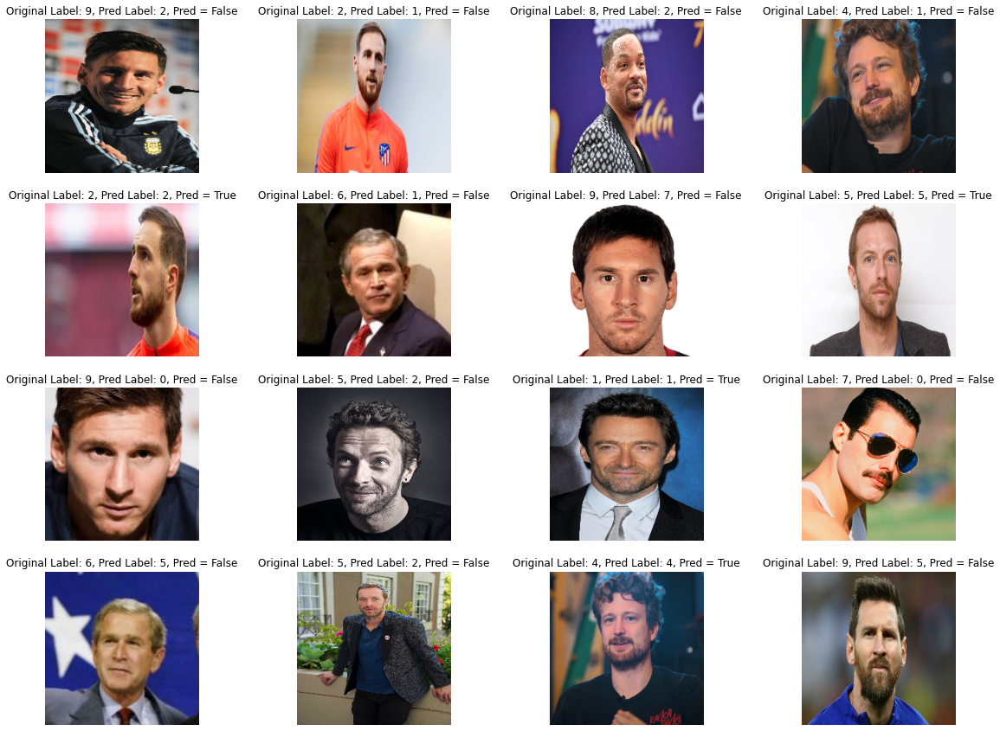

In [41]:
display_results(valid_loader, model)

## **Pretrained Models**

### **VGG16**

In [42]:
vgg16_model = models.vgg16(pretrained=True)
vgg16_model.classifier[6].out_features = faces.num_classes

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(vgg16_model.parameters())

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


In [43]:
%%time
train_model(train_loader, valid_loader, vgg16_model, optimizer, criterion, start_epoch, epochs, export_name='VGG16', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]


Epoch   1:	train loss: 1.88501	train accuracy: 6.875
		valid loss: 0.878084	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]


Epoch   2:	train loss: 0.91457	train accuracy: 11.25
		valid loss: 0.168854	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch   3:	train loss: 0.105862	train accuracy: 7.5
		valid loss: 0.13414	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]


Epoch   4:	train loss: 0.122852	train accuracy: 7.5
		valid loss: 0.152364	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch   5:	train loss: 0.0913859	train accuracy: 11.25
		valid loss: 0.184135	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch   6:	train loss: 0.111203	train accuracy: 7.5
		valid loss: 0.162846	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch   7:	train loss: 0.089625	train accuracy: 9.375
		valid loss: 0.117032	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch   8:	train loss: 0.0800718	train accuracy: 5.625
		valid loss: 0.131154	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch   9:	train loss: 0.0767632	train accuracy: 8.125
		valid loss: 0.118018	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  10:	train loss: 0.0725457	train accuracy: 13.125
		valid loss: 0.121583	valid accuracy: 5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  11:	train loss: 0.0756222	train accuracy: 8.125
		valid loss: 0.120606	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  12:	train loss: 0.0732951	train accuracy: 13.75
		valid loss: 0.119723	valid accuracy: 5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  13:	train loss: 0.0735731	train accuracy: 14.375
		valid loss: 0.117791	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  14:	train loss: 0.0720566	train accuracy: 16.875
		valid loss: 0.117759	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]


Epoch  15:	train loss: 0.0710306	train accuracy: 13.75
		valid loss: 0.120254	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  16:	train loss: 0.0723713	train accuracy: 15.625
		valid loss: 0.117367	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  17:	train loss: 0.0740592	train accuracy: 10
		valid loss: 0.126342	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  18:	train loss: 0.070829	train accuracy: 17.5
		valid loss: 0.116382	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]


Epoch  19:	train loss: 0.0701876	train accuracy: 16.25
		valid loss: 0.112503	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  20:	train loss: 0.0672972	train accuracy: 23.75
		valid loss: 0.118174	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  21:	train loss: 0.0667307	train accuracy: 20
		valid loss: 0.11498	valid accuracy: 20



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  22:	train loss: 0.0663374	train accuracy: 24.375
		valid loss: 0.124718	valid accuracy: 17.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  23:	train loss: 0.0690428	train accuracy: 21.875
		valid loss: 0.122112	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]


Epoch  24:	train loss: 0.0676842	train accuracy: 20.625
		valid loss: 0.132936	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


Epoch  25:	train loss: 0.0650311	train accuracy: 23.75
		valid loss: 0.119839	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  26:	train loss: 0.0688926	train accuracy: 23.125
		valid loss: 0.119623	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]


Epoch  27:	train loss: 0.0721945	train accuracy: 17.5
		valid loss: 0.109879	valid accuracy: 20



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  28:	train loss: 0.0697538	train accuracy: 18.75
		valid loss: 0.11217	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]


Epoch  29:	train loss: 0.0689068	train accuracy: 18.75
		valid loss: 0.110158	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]


Epoch  30:	train loss: 0.0655416	train accuracy: 20.625
		valid loss: 0.125007	valid accuracy: 30
CPU times: user 3min 51s, sys: 1min 10s, total: 5min 2s
Wall time: 5min 22s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118933545-ffcc4a00-b951-11eb-9110-748fcde0cdae.jpg) | ![](https://user-images.githubusercontent.com/52006798/118933537-fe028680-b951-11eb-9ae4-8e95f0473a5b.jpg) |


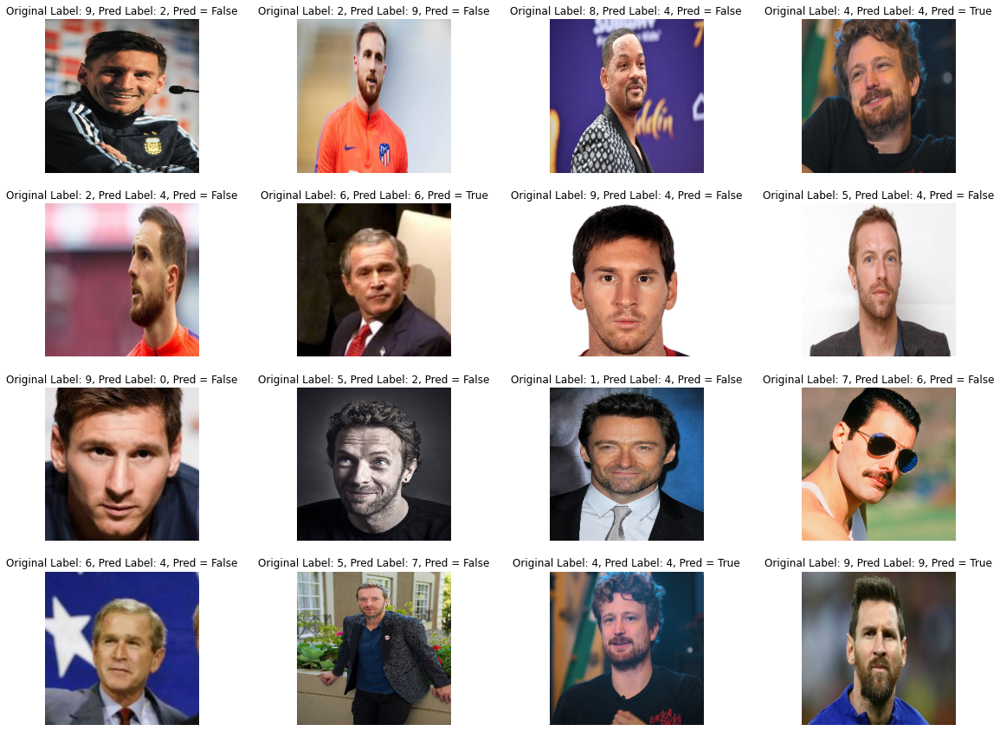

In [44]:
display_results(valid_loader, vgg16_model)

### **MobileNet**

In [45]:
mobilenet_model = models.mobilenet_v3_small(pretrained=True)
mobilenet_model.classifier[3].out_features = faces.num_classes

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(mobilenet_model.parameters())

Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth


In [46]:
%%time
train_model(train_loader, valid_loader, mobilenet_model, optimizer, criterion, start_epoch, epochs, export_name='MobileNet', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:00<00:00,  2.37it/s]


Epoch   1:	train loss: 0.160597	train accuracy: 18.75
		valid loss: 0.433311	valid accuracy: 5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.36it/s]


Epoch   2:	train loss: 0.0338844	train accuracy: 68.125
		valid loss: 0.272065	valid accuracy: 2.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]


Epoch   3:	train loss: 0.0166681	train accuracy: 80.625
		valid loss: 0.180187	valid accuracy: 17.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.56it/s]


Epoch   4:	train loss: 0.00911022	train accuracy: 91.25
		valid loss: 0.147649	valid accuracy: 20



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]


Epoch   5:	train loss: 0.00394306	train accuracy: 95.625
		valid loss: 0.165536	valid accuracy: 22.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]


Epoch   6:	train loss: 0.00426667	train accuracy: 94.375
		valid loss: 0.155531	valid accuracy: 30



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.53it/s]


Epoch   7:	train loss: 0.00355894	train accuracy: 95.625
		valid loss: 0.148665	valid accuracy: 42.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.45it/s]


Epoch   8:	train loss: 0.0031123	train accuracy: 97.5
		valid loss: 0.144862	valid accuracy: 37.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]


Epoch   9:	train loss: 0.000709653	train accuracy: 99.375
		valid loss: 0.124693	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.52it/s]


Epoch  10:	train loss: 0.00209582	train accuracy: 98.125
		valid loss: 0.111041	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]


Epoch  11:	train loss: 0.00103172	train accuracy: 98.125
		valid loss: 0.104744	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.43it/s]


Epoch  12:	train loss: 0.000150923	train accuracy: 100
		valid loss: 0.104955	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]


Epoch  13:	train loss: 0.000429097	train accuracy: 99.375
		valid loss: 0.103503	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]


Epoch  14:	train loss: 0.000292391	train accuracy: 100
		valid loss: 0.102485	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]


Epoch  15:	train loss: 0.000225688	train accuracy: 100
		valid loss: 0.10418	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]


Epoch  16:	train loss: 0.000247056	train accuracy: 100
		valid loss: 0.104755	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.49it/s]


Epoch  17:	train loss: 7.70075e-05	train accuracy: 100
		valid loss: 0.098966	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]


Epoch  18:	train loss: 0.000160073	train accuracy: 100
		valid loss: 0.0971126	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]


Epoch  19:	train loss: 0.000454719	train accuracy: 99.375
		valid loss: 0.0891488	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]


Epoch  20:	train loss: 0.000122058	train accuracy: 100
		valid loss: 0.0878548	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.50it/s]


Epoch  21:	train loss: 9.18366e-05	train accuracy: 100
		valid loss: 0.0870088	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]


Epoch  22:	train loss: 5.0126e-05	train accuracy: 100
		valid loss: 0.0866675	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]


Epoch  23:	train loss: 9.3087e-05	train accuracy: 100
		valid loss: 0.0882473	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.47it/s]


Epoch  24:	train loss: 9.94302e-05	train accuracy: 100
		valid loss: 0.0885712	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]


Epoch  25:	train loss: 8.82507e-05	train accuracy: 100
		valid loss: 0.0903894	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.46it/s]


Epoch  26:	train loss: 8.03162e-05	train accuracy: 100
		valid loss: 0.0901559	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.51it/s]


Epoch  27:	train loss: 8.82298e-05	train accuracy: 100
		valid loss: 0.0900489	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.48it/s]


Epoch  28:	train loss: 4.21383e-05	train accuracy: 100
		valid loss: 0.0893919	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]


Epoch  29:	train loss: 2.47776e-05	train accuracy: 100
		valid loss: 0.0872574	valid accuracy: 70



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.54it/s]


Epoch  30:	train loss: 3.46613e-05	train accuracy: 100
		valid loss: 0.083057	valid accuracy: 72.5
CPU times: user 1min 35s, sys: 11.9 s, total: 1min 47s
Wall time: 2min 8s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118933717-34d89c80-b952-11eb-9cdb-7918bcb9336c.jpg) | ![](https://user-images.githubusercontent.com/52006798/118933707-32764280-b952-11eb-99c6-0ac49e1d5316.jpg) |


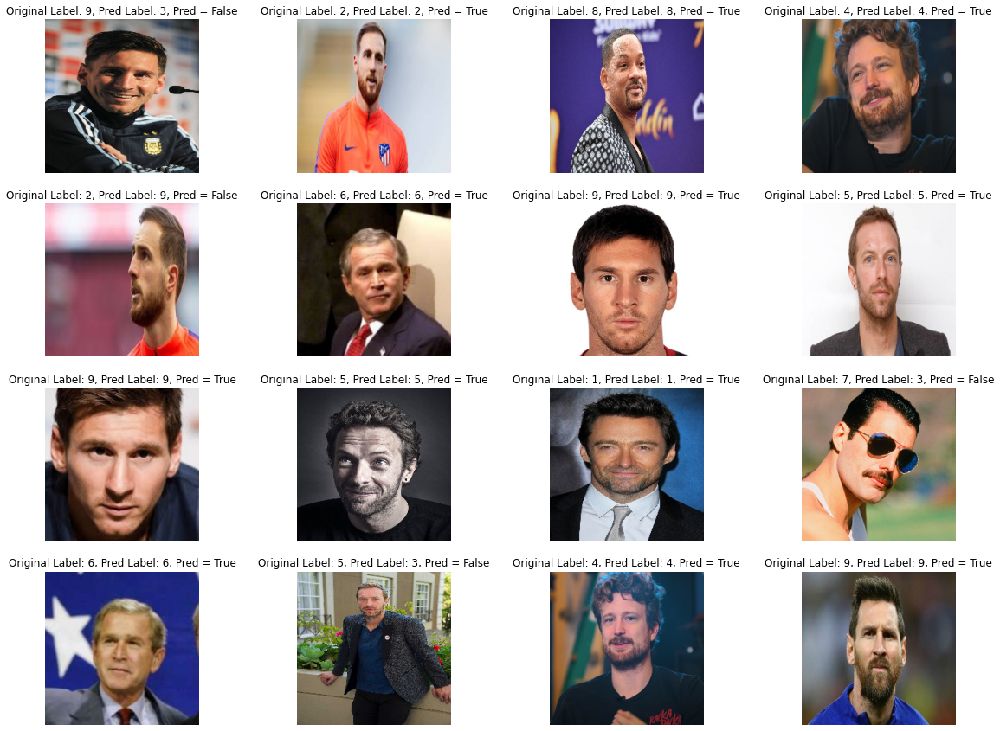

In [47]:
display_results(valid_loader, mobilenet_model)

### **GoogleNet**

In [48]:
googlenet_model = models.googlenet(pretrained=True)
googlenet_model.fc.out_features = faces.num_classes

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(googlenet_model.parameters())

Downloading: "https://download.pytorch.org/models/googlenet-1378be20.pth" to /root/.cache/torch/hub/checkpoints/googlenet-1378be20.pth


In [49]:
%%time
train_model(train_loader, valid_loader, googlenet_model, optimizer, criterion, start_epoch, epochs, export_name='GoogleNet', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch   1:	train loss: 0.153923	train accuracy: 29.375
		valid loss: 0.13151	valid accuracy: 30



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]


Epoch   2:	train loss: 0.0225025	train accuracy: 83.75
		valid loss: 0.0781727	valid accuracy: 42.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]


Epoch   3:	train loss: 0.00966525	train accuracy: 93.75
		valid loss: 0.0884229	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch   4:	train loss: 0.00712527	train accuracy: 93.125
		valid loss: 0.0894076	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch   5:	train loss: 0.00530277	train accuracy: 95.625
		valid loss: 0.0607578	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]


Epoch   6:	train loss: 0.0027176	train accuracy: 97.5
		valid loss: 0.0746544	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]


Epoch   7:	train loss: 0.00313108	train accuracy: 98.75
		valid loss: 0.0512893	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch   8:	train loss: 0.00425712	train accuracy: 96.875
		valid loss: 0.0412864	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch   9:	train loss: 0.00196136	train accuracy: 99.375
		valid loss: 0.0782217	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]


Epoch  10:	train loss: 0.00175546	train accuracy: 98.125
		valid loss: 0.0536795	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]


Epoch  11:	train loss: 0.000940913	train accuracy: 99.375
		valid loss: 0.0427716	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]


Epoch  12:	train loss: 0.000355622	train accuracy: 100
		valid loss: 0.0437038	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]


Epoch  13:	train loss: 0.00131145	train accuracy: 98.75
		valid loss: 0.0411769	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.29it/s]


Epoch  14:	train loss: 0.000897418	train accuracy: 98.75
		valid loss: 0.0427682	valid accuracy: 70



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]


Epoch  15:	train loss: 0.00140483	train accuracy: 99.375
		valid loss: 0.0562808	valid accuracy: 70



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]


Epoch  16:	train loss: 0.000230515	train accuracy: 100
		valid loss: 0.0597494	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.30it/s]


Epoch  17:	train loss: 0.00158564	train accuracy: 98.75
		valid loss: 0.0454813	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch  18:	train loss: 0.000344419	train accuracy: 100
		valid loss: 0.0399487	valid accuracy: 82.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch  19:	train loss: 0.000159538	train accuracy: 100
		valid loss: 0.0415782	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch  20:	train loss: 0.000244233	train accuracy: 100
		valid loss: 0.0417276	valid accuracy: 80



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch  21:	train loss: 0.000550522	train accuracy: 99.375
		valid loss: 0.0423647	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch  22:	train loss: 3.05969e-05	train accuracy: 100
		valid loss: 0.0466596	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch  23:	train loss: 0.000226281	train accuracy: 99.375
		valid loss: 0.0477862	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.28it/s]


Epoch  24:	train loss: 4.19588e-05	train accuracy: 100
		valid loss: 0.0468794	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch  25:	train loss: 3.56043e-05	train accuracy: 100
		valid loss: 0.0452242	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]


Epoch  26:	train loss: 0.000156609	train accuracy: 100
		valid loss: 0.0455275	valid accuracy: 75



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.25it/s]


Epoch  27:	train loss: 0.000109084	train accuracy: 100
		valid loss: 0.0401049	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.33it/s]


Epoch  28:	train loss: 2.94967e-05	train accuracy: 100
		valid loss: 0.0378824	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.26it/s]


Epoch  29:	train loss: 2.83449e-05	train accuracy: 100
		valid loss: 0.0371863	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:00<00:00,  2.31it/s]


Epoch  30:	train loss: 0.000179063	train accuracy: 100
		valid loss: 0.0372873	valid accuracy: 77.5
CPU times: user 1min 51s, sys: 23.4 s, total: 2min 15s
Wall time: 2min 35s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118933912-6c474900-b952-11eb-83fe-0d293265cad8.jpg) | ![](https://user-images.githubusercontent.com/52006798/118933907-6b161c00-b952-11eb-8ad1-c41f74edb797.jpg) |


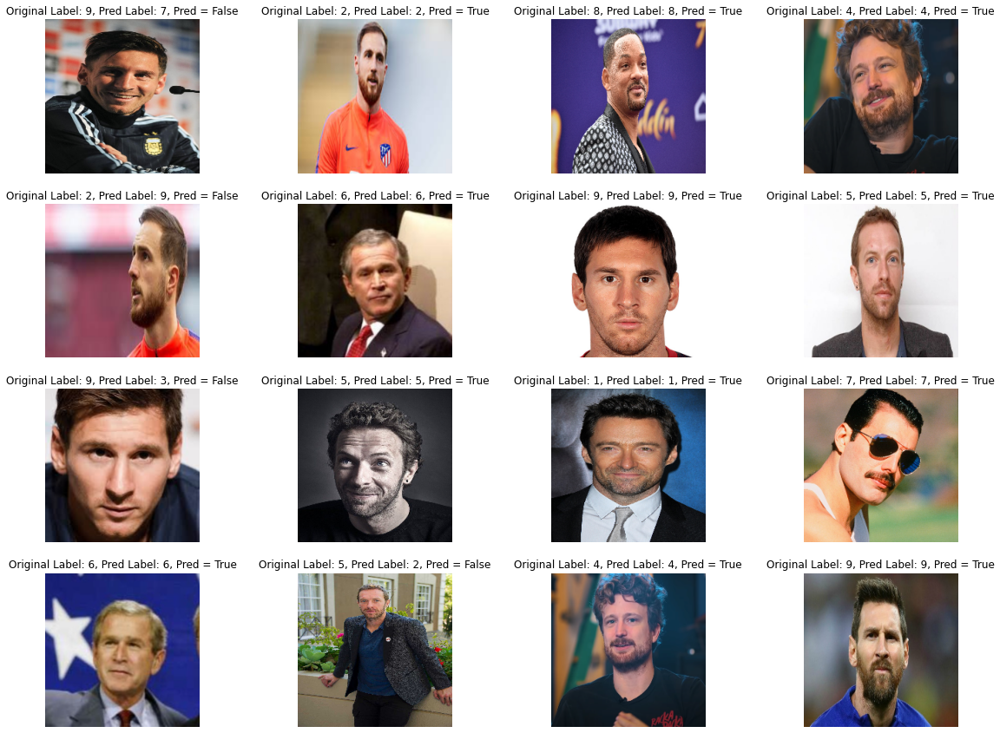

In [50]:
display_results(valid_loader, googlenet_model)

### **ResNet**

In [51]:
resnet152_model = models.resnet152(pretrained=True)
resnet152_model.fc.out_features = faces.num_classes

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(resnet152_model.parameters())

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to /root/.cache/torch/hub/checkpoints/resnet152-b121ed2d.pth


In [52]:
%%time
train_model(train_loader, valid_loader, resnet152_model, optimizer, criterion, start_epoch, epochs, export_name='RESNET152_', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]


Epoch   1:	train loss: 0.143951	train accuracy: 34.375
		valid loss: 0.943008	valid accuracy: 17.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch   2:	train loss: 0.0463508	train accuracy: 58.75
		valid loss: 9.22888	valid accuracy: 7.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch   3:	train loss: 0.0266643	train accuracy: 71.875
		valid loss: 3.71644	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch   4:	train loss: 0.02603	train accuracy: 74.375
		valid loss: 2.30962	valid accuracy: 12.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch   5:	train loss: 0.0205366	train accuracy: 78.75
		valid loss: 0.612312	valid accuracy: 20



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch   6:	train loss: 0.00983395	train accuracy: 90.625
		valid loss: 0.257253	valid accuracy: 35



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Epoch   7:	train loss: 0.00429072	train accuracy: 96.25
		valid loss: 0.0914407	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]


Epoch   8:	train loss: 0.00519367	train accuracy: 95.625
		valid loss: 0.10692	valid accuracy: 55



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch   9:	train loss: 0.00324197	train accuracy: 96.25
		valid loss: 0.109872	valid accuracy: 52.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  10:	train loss: 0.002799	train accuracy: 98.125
		valid loss: 0.106304	valid accuracy: 52.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  11:	train loss: 0.0044166	train accuracy: 97.5
		valid loss: 0.117785	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  12:	train loss: 0.00156966	train accuracy: 98.75
		valid loss: 0.12364	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  13:	train loss: 0.00232823	train accuracy: 98.125
		valid loss: 0.10192	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  14:	train loss: 0.00141413	train accuracy: 98.75
		valid loss: 0.127627	valid accuracy: 50



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  15:	train loss: 0.000920578	train accuracy: 99.375
		valid loss: 0.0927054	valid accuracy: 52.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  16:	train loss: 0.000838697	train accuracy: 99.375
		valid loss: 0.0913828	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]


Epoch  17:	train loss: 0.00136133	train accuracy: 98.125
		valid loss: 0.110991	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  18:	train loss: 0.0018406	train accuracy: 98.125
		valid loss: 0.115559	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  19:	train loss: 0.00331691	train accuracy: 96.25
		valid loss: 0.137393	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]


Epoch  20:	train loss: 0.00271147	train accuracy: 98.125
		valid loss: 0.154961	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  21:	train loss: 0.00382176	train accuracy: 96.875
		valid loss: 0.144407	valid accuracy: 50



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  22:	train loss: 0.0028784	train accuracy: 96.25
		valid loss: 0.111994	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  23:	train loss: 0.00258067	train accuracy: 96.25
		valid loss: 0.102766	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]


Epoch  24:	train loss: 0.00200117	train accuracy: 98.75
		valid loss: 0.100193	valid accuracy: 52.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  25:	train loss: 0.00271722	train accuracy: 96.875
		valid loss: 0.110277	valid accuracy: 45



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  26:	train loss: 0.00191404	train accuracy: 97.5
		valid loss: 0.186506	valid accuracy: 50



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]


Epoch  27:	train loss: 0.00134371	train accuracy: 99.375
		valid loss: 0.109381	valid accuracy: 50



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]


Epoch  28:	train loss: 0.00322509	train accuracy: 97.5
		valid loss: 0.097732	valid accuracy: 60



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  29:	train loss: 0.00162892	train accuracy: 98.125
		valid loss: 0.0836114	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]


Epoch  30:	train loss: 0.00216877	train accuracy: 97.5
		valid loss: 0.0884551	valid accuracy: 57.5
CPU times: user 4min 1s, sys: 2min 59s, total: 7min 1s
Wall time: 7min 22s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118934035-91d45280-b952-11eb-9c2d-040b8d8d7c06.jpg) | ![](https://user-images.githubusercontent.com/52006798/118934025-900a8f00-b952-11eb-936d-84750244747a.jpg) |


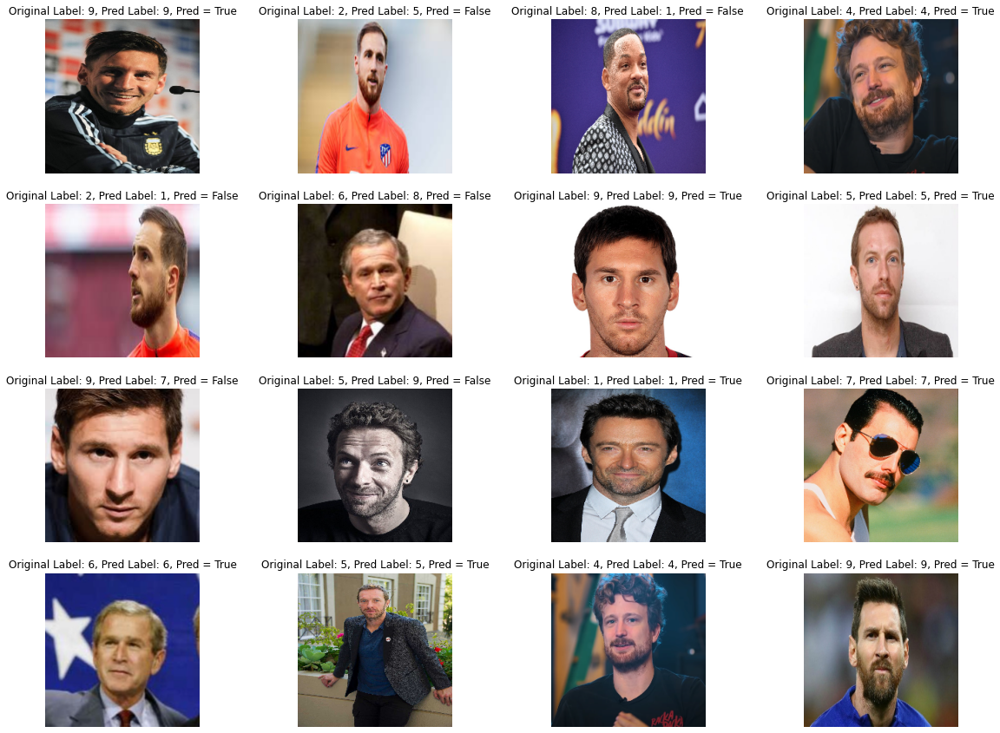

In [53]:
display_results(valid_loader, resnet152_model)

### **DenseNet**

In [54]:
densenet121_model = models.densenet121(pretrained=True)
densenet121_model.classifier.out_features = faces.num_classes

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(densenet121_model.parameters())

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth


In [55]:
%%time
train_model(train_loader, valid_loader, densenet121_model, optimizer, criterion, start_epoch, epochs, export_name='densenet121', exp_num=experiment)
start_epoch += epochs

Valid: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


Epoch   1:	train loss: 0.168009	train accuracy: 27.5
		valid loss: 0.302103	valid accuracy: 10



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]


Epoch   2:	train loss: 0.0255158	train accuracy: 81.875
		valid loss: 0.22162	valid accuracy: 22.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]


Epoch   3:	train loss: 0.00897991	train accuracy: 91.875
		valid loss: 0.280718	valid accuracy: 15



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]


Epoch   4:	train loss: 0.0059625	train accuracy: 95
		valid loss: 0.164581	valid accuracy: 47.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]


Epoch   5:	train loss: 0.00449136	train accuracy: 96.25
		valid loss: 0.0861202	valid accuracy: 52.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.80it/s]


Epoch   6:	train loss: 0.00363189	train accuracy: 97.5
		valid loss: 0.0896298	valid accuracy: 55



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch   7:	train loss: 0.00181351	train accuracy: 98.125
		valid loss: 0.0606389	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]


Epoch   8:	train loss: 0.00163587	train accuracy: 98.75
		valid loss: 0.070044	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]


Epoch   9:	train loss: 0.00220557	train accuracy: 98.75
		valid loss: 0.0877688	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]


Epoch  10:	train loss: 0.00360258	train accuracy: 96.25
		valid loss: 0.0839251	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


Epoch  11:	train loss: 0.000396368	train accuracy: 100
		valid loss: 0.0674899	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]


Epoch  12:	train loss: 0.00189959	train accuracy: 97.5
		valid loss: 0.066906	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  13:	train loss: 0.000674894	train accuracy: 99.375
		valid loss: 0.0811289	valid accuracy: 62.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.84it/s]


Epoch  14:	train loss: 0.00125067	train accuracy: 99.375
		valid loss: 0.0950244	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]


Epoch  15:	train loss: 0.00106855	train accuracy: 99.375
		valid loss: 0.0894153	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


Epoch  16:	train loss: 0.000860778	train accuracy: 99.375
		valid loss: 0.0715752	valid accuracy: 57.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.80it/s]


Epoch  17:	train loss: 0.000767757	train accuracy: 99.375
		valid loss: 0.0584261	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


Epoch  18:	train loss: 0.000881187	train accuracy: 99.375
		valid loss: 0.0561239	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]


Epoch  19:	train loss: 0.00104982	train accuracy: 99.375
		valid loss: 0.0503906	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.79it/s]


Epoch  20:	train loss: 0.00076238	train accuracy: 99.375
		valid loss: 0.0514457	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.87it/s]


Epoch  21:	train loss: 0.00035807	train accuracy: 100
		valid loss: 0.0479274	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]


Epoch  22:	train loss: 0.000341971	train accuracy: 100
		valid loss: 0.0458956	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  23:	train loss: 0.000152863	train accuracy: 100
		valid loss: 0.0497001	valid accuracy: 67.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  24:	train loss: 0.000133495	train accuracy: 100
		valid loss: 0.053293	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  25:	train loss: 0.000554926	train accuracy: 98.75
		valid loss: 0.0506721	valid accuracy: 77.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  26:	train loss: 8.97285e-05	train accuracy: 100
		valid loss: 0.0569942	valid accuracy: 72.5



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.86it/s]


Epoch  27:	train loss: 0.000135619	train accuracy: 100
		valid loss: 0.057419	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]


Epoch  28:	train loss: 0.000376549	train accuracy: 99.375
		valid loss: 0.0589084	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]


Epoch  29:	train loss: 0.000123868	train accuracy: 100
		valid loss: 0.0599601	valid accuracy: 65



Valid: 100%|██████████| 2/2 [00:01<00:00,  1.85it/s]


Epoch  30:	train loss: 0.00047433	train accuracy: 99.375
		valid loss: 0.0509474	valid accuracy: 70
CPU times: user 2min 34s, sys: 1min 15s, total: 3min 50s
Wall time: 4min 11s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118934243-d2cc6700-b952-11eb-8139-1aff6ab33ca1.jpg) | ![](https://user-images.githubusercontent.com/52006798/118934240-d102a380-b952-11eb-866c-3363dbf658ef.jpg) |


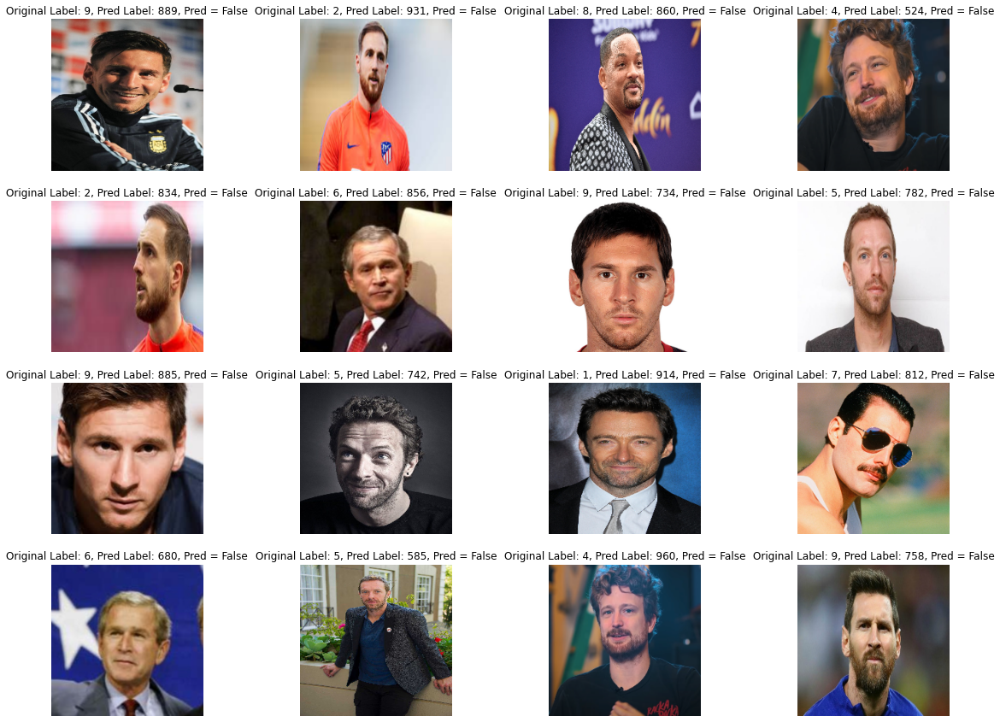

In [61]:
display_results(valid_loader, densenet121_model)

## Model Comparison

### Training
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118935603-62264a00-b954-11eb-890d-7eaea8fd80d4.jpg) | ![](https://user-images.githubusercontent.com/52006798/118935621-65b9d100-b954-11eb-8ec9-81a02a619b63.jpg) |


### Validation
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118935746-87b35380-b954-11eb-85c6-5c07a6efe412.jpg) | ![](https://user-images.githubusercontent.com/52006798/118935749-884bea00-b954-11eb-8c57-10f817ebcf96.jpg) |


## **Ensemble**

Reduce in the batch size is required because of Colab's GPU's limitations.

In [65]:
BATCH_SIZE = 8
train_loader = DataLoader(dataset=trainset, batch_size= BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(dataset=validset, batch_size= BATCH_SIZE, shuffle=False)

In [66]:
total_in = 0

total_in += vgg16_model.classifier[6].in_features
vgg16_model.classifier[6] = nn.Identity()

total_in += mobilenet_model.classifier[3].in_features
mobilenet_model.classifier[3] = nn.Identity()

total_in += googlenet_model.fc.in_features
googlenet_model.fc = nn.Identity()

total_in += resnet152_model.fc.in_features
resnet152_model.fc = nn.Identity()

total_in += densenet121_model.classifier.in_features
densenet121_model.classifier = nn.Identity()

In [67]:
class EnsembleModel(nn.Module):
    def __init__(self, model1, model2, model3, model4, model5, in_dim, out_dim):
        super(EnsembleModel, self).__init__()
        self.model1 = model1
        self.model2 = model2
        self.model3 = model3
        self.model4 = model4
        self.model5 = model5
        
        # Create new classifier
        self.classifier = nn.Linear(in_dim, out_dim)
        
    def forward(self, x):
        x1 = self.model1(x)
        x1 = x1.view(x1.size(0), -1)
        x2 = self.model2(x)
        x2 = x2.view(x2.size(0), -1)
        x3 = self.model3(x) 
        x3 = x3.view(x3.size(0), -1)
        x4 = self.model4(x)
        x4 = x4.view(x4.size(0), -1)
        x5 = self.model5(x)
        x5 = x5.view(x4.size(0), -1)
        x = torch.cat((x1, x2, x3, x4, x5), dim=1)
        
        x = self.classifier(F.relu(x))
        return x

In [68]:
ensemble_model = EnsembleModel(densenet121_model, resnet152_model, googlenet_model, mobilenet_model, vgg16_model, total_in, faces.num_classes)

start_epoch = 0
experiment += 1
epochs = 30
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(ensemble_model.parameters())
scheduler = None

In [69]:
%%time
train_model(train_loader, valid_loader, ensemble_model, optimizer, criterion, start_epoch, epochs, export_name='ensemble', exp_num=experiment, scheduler=scheduler)
start_epoch += epochs

Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch   1:	train loss: 0.764473	train accuracy: 18.125
		valid loss: 469.347	valid accuracy: 7.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]


Epoch   2:	train loss: 0.359388	train accuracy: 53.75
		valid loss: 10.3456	valid accuracy: 17.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch   3:	train loss: 0.0966384	train accuracy: 76.875
		valid loss: 0.503269	valid accuracy: 25



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]


Epoch   4:	train loss: 0.0647914	train accuracy: 86.25
		valid loss: 0.226864	valid accuracy: 60



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch   5:	train loss: 0.0639888	train accuracy: 85.625
		valid loss: 5.45461	valid accuracy: 35



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]


Epoch   6:	train loss: 0.0781315	train accuracy: 83.125
		valid loss: 0.834687	valid accuracy: 42.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch   7:	train loss: 0.112601	train accuracy: 74.375
		valid loss: 0.441642	valid accuracy: 37.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]


Epoch   8:	train loss: 0.0539992	train accuracy: 86.25
		valid loss: 0.503099	valid accuracy: 50



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.63it/s]


Epoch   9:	train loss: 0.0562858	train accuracy: 86.25
		valid loss: 0.881304	valid accuracy: 57.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]


Epoch  10:	train loss: 0.03865	train accuracy: 90
		valid loss: 0.313586	valid accuracy: 55



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  11:	train loss: 0.0297638	train accuracy: 94.375
		valid loss: 0.285615	valid accuracy: 60



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch  12:	train loss: 0.0260169	train accuracy: 93.75
		valid loss: 12.3909	valid accuracy: 20



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.61it/s]


Epoch  13:	train loss: 0.0217214	train accuracy: 93.75
		valid loss: 0.435939	valid accuracy: 60



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.61it/s]


Epoch  14:	train loss: 0.0151251	train accuracy: 96.25
		valid loss: 0.242047	valid accuracy: 65



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.57it/s]


Epoch  15:	train loss: 0.0225281	train accuracy: 95.625
		valid loss: 0.524843	valid accuracy: 57.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch  16:	train loss: 0.00665313	train accuracy: 97.5
		valid loss: 0.3351	valid accuracy: 65



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch  17:	train loss: 0.0163937	train accuracy: 95.625
		valid loss: 0.221526	valid accuracy: 65



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  18:	train loss: 0.0348568	train accuracy: 94.375
		valid loss: 0.378609	valid accuracy: 67.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  19:	train loss: 0.0230007	train accuracy: 93.125
		valid loss: 0.35722	valid accuracy: 52.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.57it/s]


Epoch  20:	train loss: 0.0306456	train accuracy: 93.125
		valid loss: 0.73275	valid accuracy: 65



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch  21:	train loss: 0.0394466	train accuracy: 91.25
		valid loss: 1.1308	valid accuracy: 35



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]


Epoch  22:	train loss: 0.0299306	train accuracy: 96.875
		valid loss: 0.551877	valid accuracy: 62.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]


Epoch  23:	train loss: 0.0140876	train accuracy: 96.25
		valid loss: 0.387951	valid accuracy: 77.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  24:	train loss: 0.0297775	train accuracy: 95.625
		valid loss: 0.344887	valid accuracy: 72.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  25:	train loss: 0.00756768	train accuracy: 97.5
		valid loss: 0.328266	valid accuracy: 65



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  26:	train loss: 0.04764	train accuracy: 91.875
		valid loss: 1.3536	valid accuracy: 42.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.61it/s]


Epoch  27:	train loss: 0.0322178	train accuracy: 93.125
		valid loss: 0.30365	valid accuracy: 72.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.62it/s]


Epoch  28:	train loss: 0.0350764	train accuracy: 93.75
		valid loss: 0.36826	valid accuracy: 67.5



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.60it/s]


Epoch  29:	train loss: 0.0157405	train accuracy: 95.625
		valid loss: 0.270198	valid accuracy: 70



Valid: 100%|██████████| 5/5 [00:03<00:00,  1.59it/s]


Epoch  30:	train loss: 0.0126729	train accuracy: 95.625
		valid loss: 0.243514	valid accuracy: 72.5
CPU times: user 12min 19s, sys: 8min 38s, total: 20min 58s
Wall time: 21min 20s


#### **Graphs & Samples**
| *Loss* | *Accuracy* | 
| :---: | :---: |
| ![](https://user-images.githubusercontent.com/52006798/118937847-a1ee3100-b956-11eb-8f89-af22fa2d3e09.jpg) | ![](https://user-images.githubusercontent.com/52006798/118937853-a4508b00-b956-11eb-9a17-89b7f0d9c623.jpg)
 |


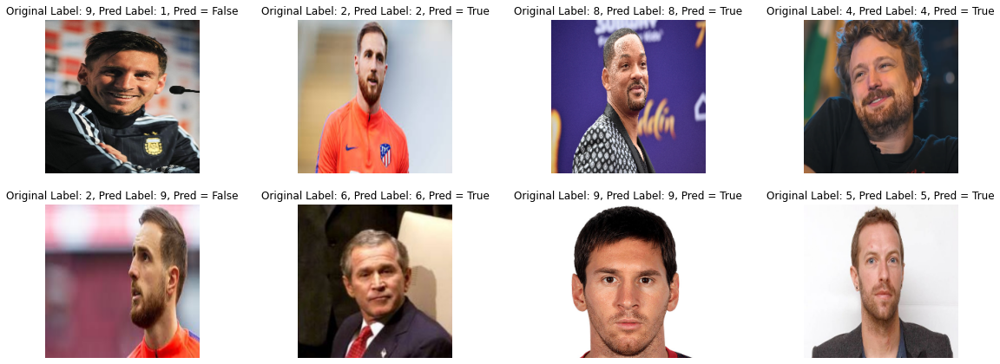

In [72]:
display_results(valid_loader, ensemble_model)

## **Summary**
In this Summarize Excercise, we used the faces dataset that we created at the previous exercise in order to train several face recognition models.  
We have implemented our own VGG16 model and as we can see from the results, the model doesn't train well.  
Moreover, we have performed transfer learning from 5 different pre-trained `torchvision` models. All the models were pre-trained on an 'ImageNet' dataset which contains 1,000 classes and more than 1,000,000 images.  
Then, we used an ensemble model that combined all of those 5 model's last layers on purpose to get better predictions.  
#### **Results**
First, we compared our VGG16 model to a pre-trained model and as we can see from the results, the pre-trained model gave us slightly better results, but still not satisfactory results.  
Except VGG16, we trained `MobileNet`, `GoogleNet`, `ResNet` and `DesnseNet` models.  
From the pre-trained models, we get the best accuracy with **`DenseNet`**.  
Except for the VGG16 model, all of the other models gave us similar results.
